<a href="https://colab.research.google.com/github/SubhrjiT/First-Repository/blob/main/House_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **NAME : SUBHRAJIT BEHERA**

***EMAIL : subhrajitbehera6370@gmail.com***

# ***Project Name:***

**House prediction Project**





Our data comes from Real_estate that makes   ***House Prices: linear Regression Techniques***. It contains 415  training data points  that might help us predict the selling price of a house.

**Load the data**

Let’s load the from the drive linked bellow:

https://drive.google.com/file/d/1l3N_uPyJjcE_7nFr18WuiNHwIqHC0G1h/view?usp=sharing


In [6]:
import numpy as np
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import rc
import unittest

%matplotlib inline

sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 14, 8

RANDOM_SEED = 42

np.random.seed(RANDOM_SEED)

def run_tests():
  unittest.main(argv=[''], verbosity=1, exit=False)

# Load the data

Data [House Prices: Linear Regression Techniques](https://drive.google.com/file/d/1l3N_uPyJjcE_7nFr18WuiNHwIqHC0G1h/view?usp=sharing)

In [7]:
df_train=pd.read_csv("Real_estate.csv")

In [8]:
df_train.head()

,No,X1 transaction date,X2 house age,X3 distance to the nearest MRT station,X4 number of convenience stores,X5 latitude,X6 longitude,Y house price of unit area
0,1,2012.917,32.0,84.87882,10,24.98298,121.54024,37.9
1,2,2012.917,19.5,306.59470,9,24.98034,121.53951,42.2
2,3,2013.583,13.3,561.98450,5,24.98746,121.54391,47.3
3,4,2013.500,13.3,561.98450,5,24.98746,121.54391,54.8
4,5,2012.833,5.0,390.56840,5,24.97937,121.54245,43.1


In [9]:
df_train.info(

)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 414 entries, 0 to 413
Data columns (total 8 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   No                                      414 non-null    int64  
 1   X1 transaction date                     414 non-null    float64
 2   X2 house age                            414 non-null    float64
 3   X3 distance to the nearest MRT station  414 non-null    float64
 4   X4 number of convenience stores         414 non-null    int64  
 5   X5 latitude                             414 non-null    float64
 6   X6 longitude                            414 non-null    float64
 7   Y house price of unit area              414 non-null    float64
dtypes: float64(6), int64(2)
memory usage: 26.0 KB


In [10]:
df_train.describe

<bound method NDFrame.describe of       No  X1 transaction date  X2 house age  \
0      1             2012.917          32.0   
1      2             2012.917          19.5   
2      3             2013.583          13.3   
3      4             2013.500          13.3   
4      5             2012.833           5.0   
..   ...                  ...           ...   
409  410             2013.000          13.7   
410  411             2012.667           5.6   
411  412             2013.250          18.8   
412  413             2013.000           8.1   
413  414             2013.500           6.5   

     X3 distance to the nearest MRT station  X4 number of convenience stores  \
0                                  84.87882                               10   
1                                 306.59470                                9   
2                                 561.98450                                5   
3                                 561.98450                                5   
4

# Data exploration

In [11]:

df_train['Y house price of unit area'].describe()

count    414.000000
mean      37.980193
std       13.606488
min        7.600000
25%       27.700000
50%       38.450000
75%       46.600000
max      117.500000
Name: Y house price of unit area, dtype: float64

<ipython-input-12-34e32b9c6ca4>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df_train['Y house price of unit area']);


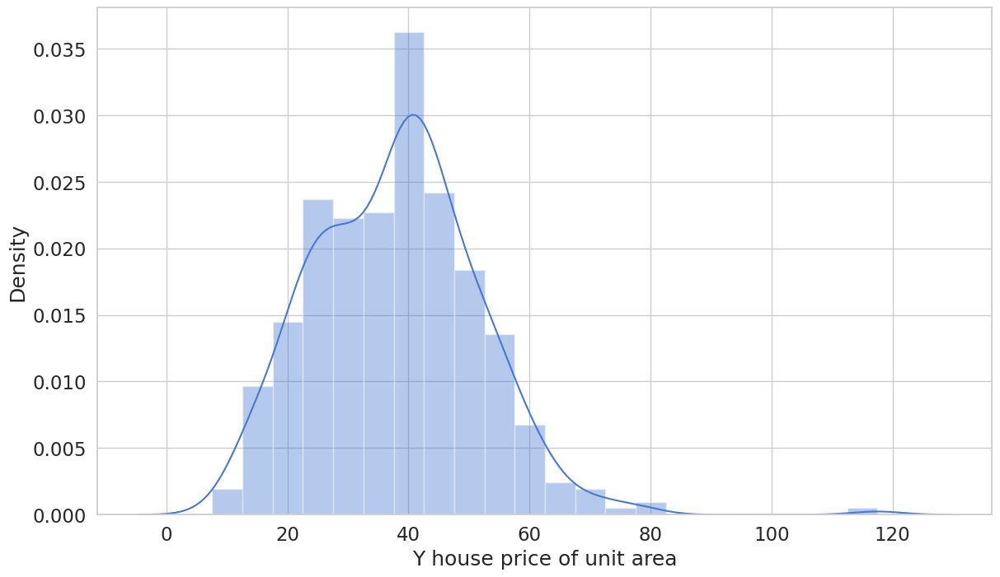

In [12]:
sns.distplot(df_train['Y house price of unit area']);

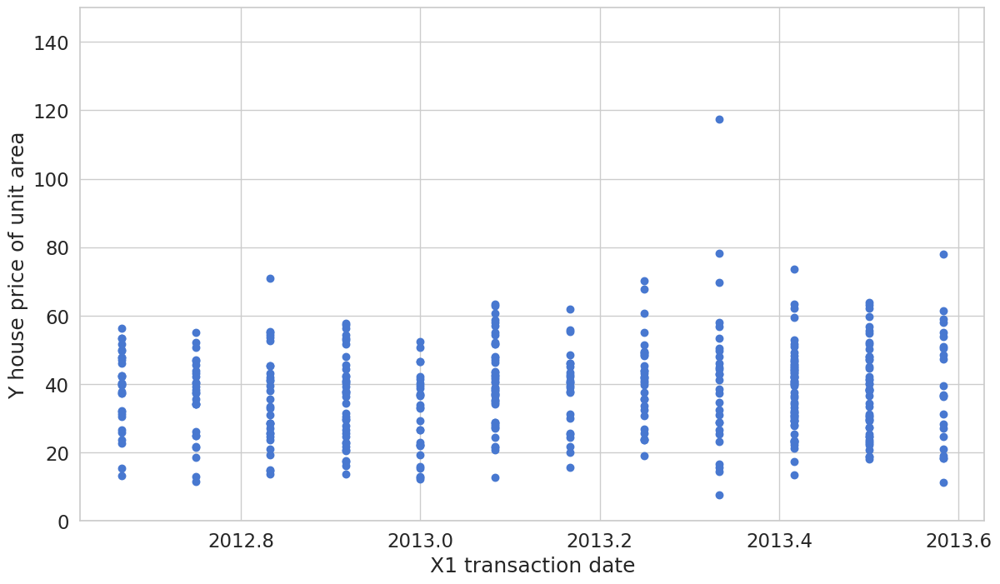

In [13]:
var = 'X1 transaction date'
data = pd.concat([df_train['Y house price of unit area'], df_train[var]], axis=1)
data.plot.scatter(x=var, y='Y house price of unit area', ylim=(0,150), s=37);

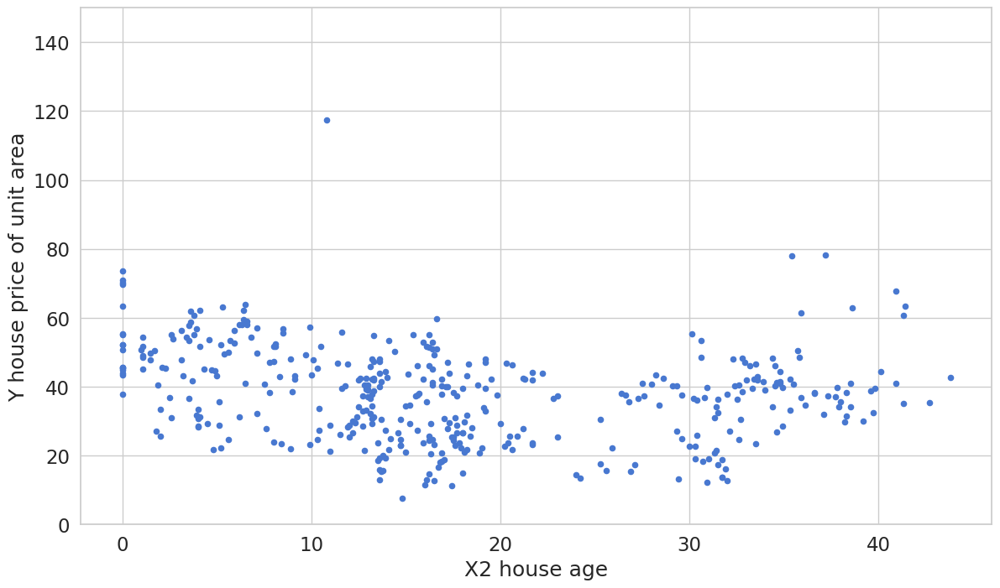

In [14]:
var = 'X2 house age'
data = pd.concat([df_train['Y house price of unit area'], df_train[var]], axis=1)
data.plot.scatter(x=var, y='Y house price of unit area', ylim=(0,150));

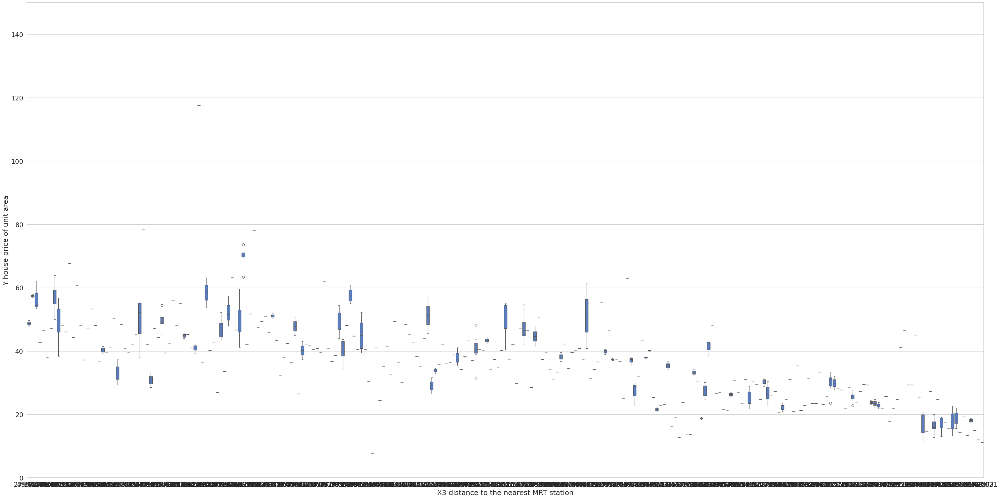

In [15]:
var ='X3 distance to the nearest MRT station'
data = pd.concat([df_train['Y house price of unit area'], df_train[var]], axis=1)
f, ax = plt.subplots(figsize=(44, 22))
fig = sns.boxplot(x=var, y="Y house price of unit area", data=data)
fig.axis(ymin=0, ymax=150);

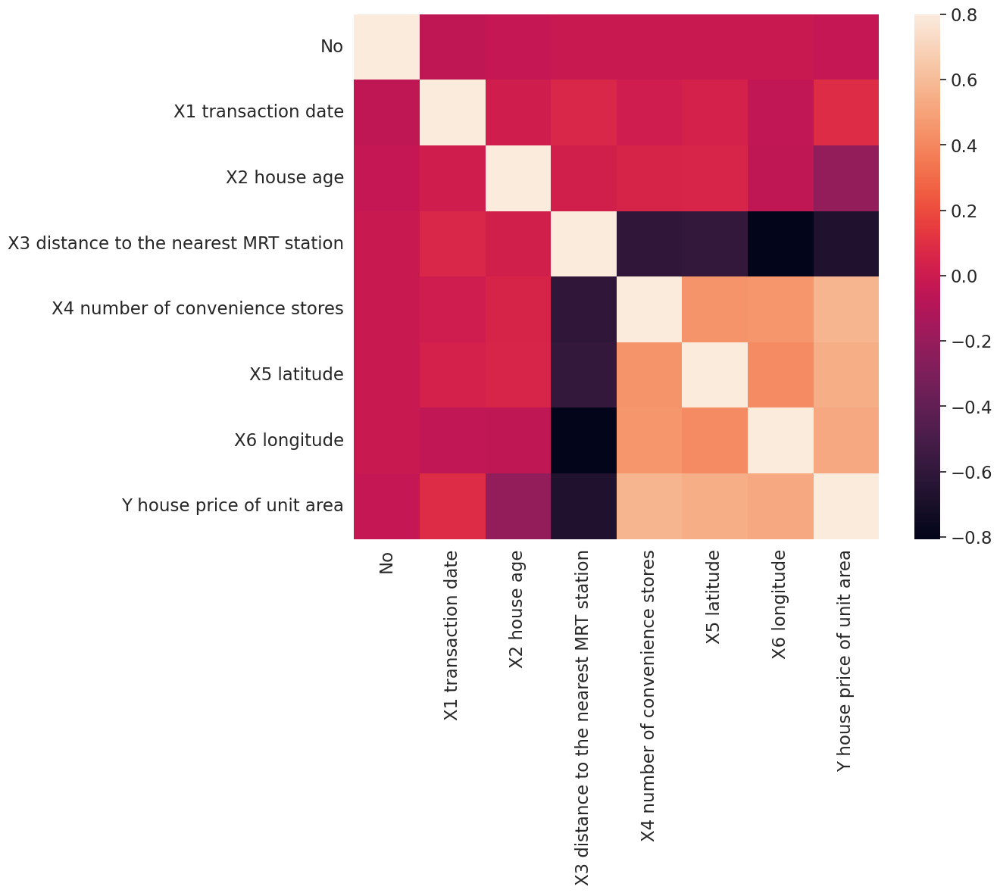

In [16]:
corrmat = df_train.corr()
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(corrmat, vmax=.8, square=True);

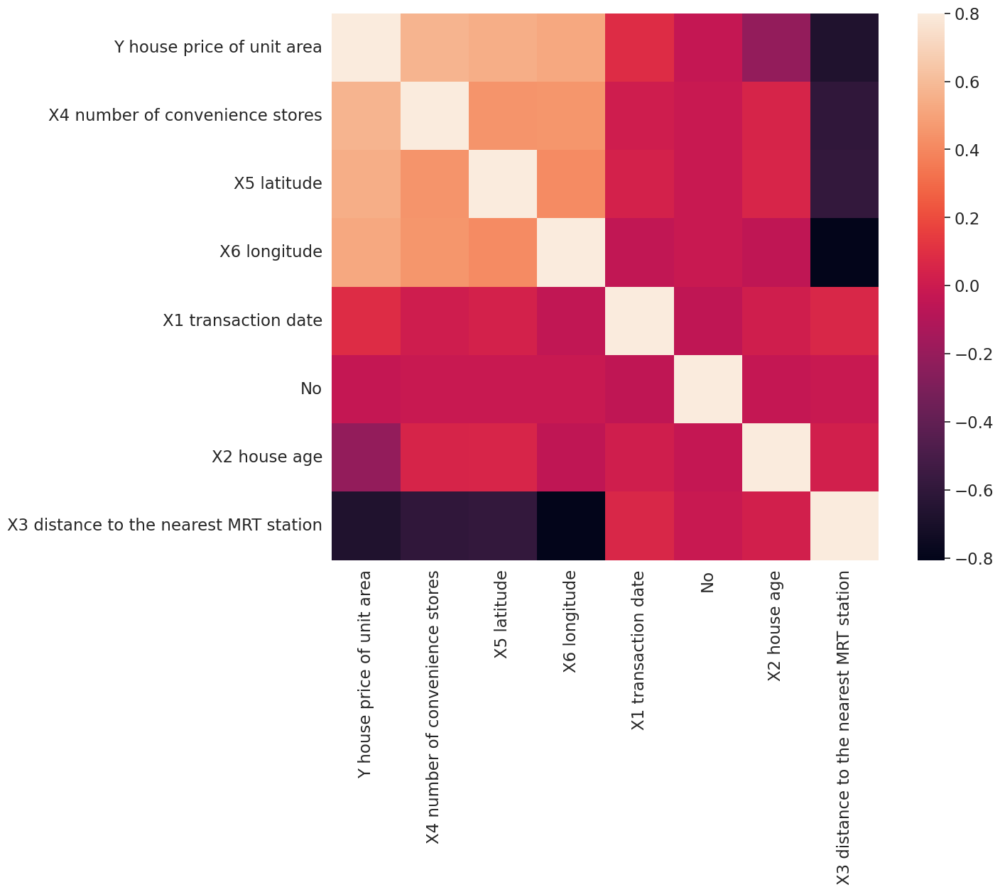

In [17]:
k = 9 #number of variables for heatmap
cols = corrmat.nlargest(k, 'Y house price of unit area')['Y house price of unit area'].index
f, ax = plt.subplots(figsize=(14, 10))
sns.heatmap(df_train[cols].corr(), vmax=.8, square=True);

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:2100: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


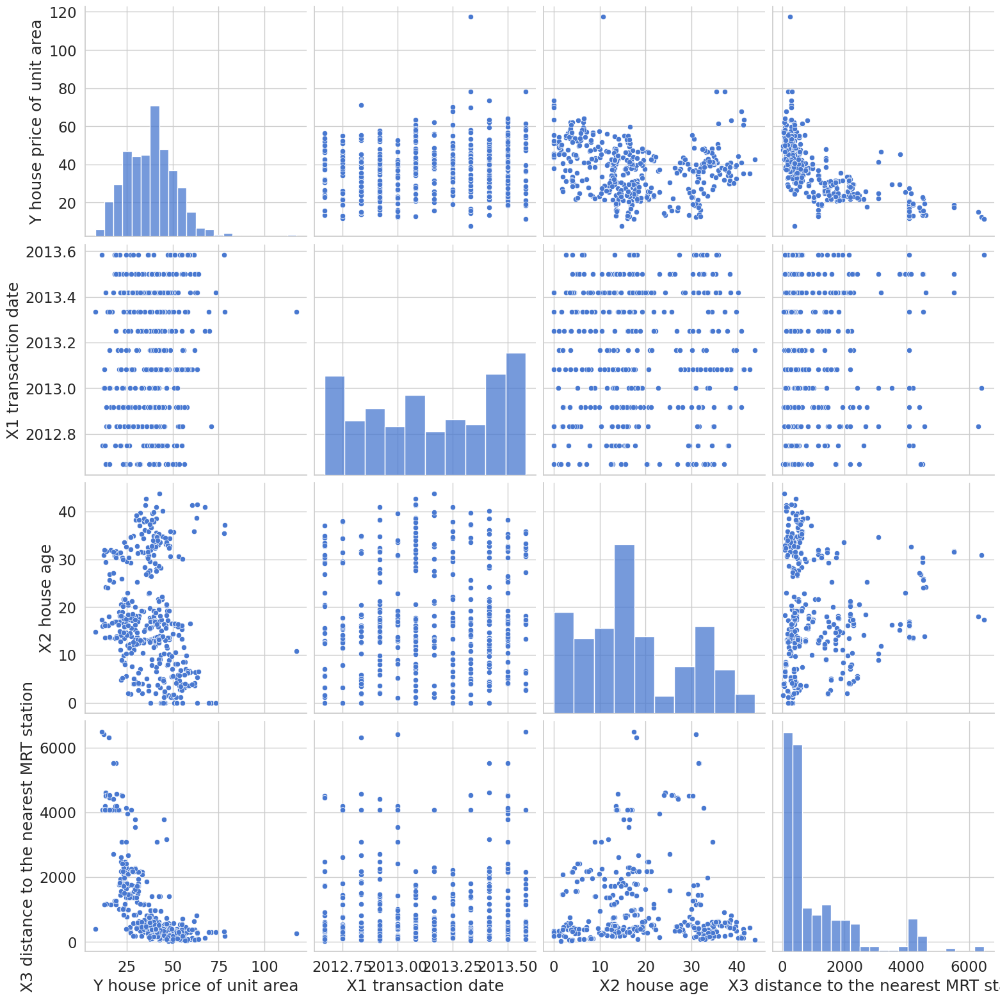

In [18]:
cols = ['Y house price of unit area', 'X1 transaction date', 'X2 house age', 'X3 distance to the nearest MRT station']
sns.pairplot(df_train[cols], size = 4);

## Do we have missing data?

In [19]:
total = df_train.isnull().sum().sort_values(ascending=False)
percent = (df_train.isnull().sum()/df_train.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head(8)

,Total,Percent
No,0,0.0
X1 transaction date,0,0.0
X2 house age,0,0.0
X3 distance to the nearest MRT station,0,0.0
X4 number of convenience stores,0,0.0
X5 latitude,0,0.0
X6 longitude,0,0.0
Y house price of unit area,0,0.0


# Predicting the sale price
___________________________________

***## Preparing the data***


**### Feature scaling**

We will do a little preprocessing to our data using the following formula (standardization):

$$x'= \frac{x - \mu}{\sigma}$$

where $\mu$ is the population mean and $\sigma$ is the standard deviation.

![](https://leonardoaraujosantos.gitbooks.io/artificial-inteligence/content/image_folder_5/FeatureScaling.jpg)



In [20]:
x = df_train['X1 transaction date']
y = df_train['Y house price of unit area']

x = (x - x.mean()) / x.std()
x = np.c_[np.ones(x.shape[0]), x]

In [21]:
x.shape

(414, 2)

## Linear Regression

![](https://i.ytimg.com/vi/zPG4NjIkCjc/maxresdefault.jpg)

**Source: MyBookSucks**

Linear regression models assume that the relationship between a dependent continuous variable $Y$ and one or more explanatory (independent) variables $X$ is linear (that is, a straight line). It’s used to predict values within a continuous range, (e.g. sales, price) rather than trying to classify them into categories (e.g. cat, dog). Linear regression models can be divided into two main types:

### Simple Linear Regression

Simple linear regression uses a traditional slope-intercept form, where $a$ and $b$ are the coefficients that we try to “learn” and produce the most accurate predictions. $X$ represents our input data and $Y$ is our prediction.

$$Y = bX + a$$

![](https://spss-tutorials.com/img/simple-linear-regression-equation-linear-relation.png)

**Source: SPSS tutorials**

### Multivariable Regression

A more complex, multi-variable linear equation might look like this, where w represents the coefficients, or weights, our model will try to learn.

$$ Y(x_1,x_2,x_3) = w_1 x_1 + w_2 x_2 + w_3 x_3 + w_0$$

The variables $x_1, x_2, x_3$ represent the attributes, or distinct pieces of information, we have about each observation.

## Loss function

Given our Simple Linear Regression equation:

$$Y = bX + a$$

We can use the following cost function to find the coefficients:

### Mean Squared Error (MSE) Cost Function

The MSE is defined as:

$$MSE = J(W) =  \frac{1}{m} \sum_{i=1}^{m} (y^{(i)} - h_w(x^{(i)}))^2$$

where

$$h_w(x) = g(w^Tx)$$

The MSE measures how much the average model predictions vary from the correct values. The number is higher when the model is performing "bad" on the training set.

The first derivative of MSE is given by:

$$MSE' = J'(W) = \frac{2}{m} \sum_{i=1}^{m} (h_w(x^{(i)}) - y^{(i)})$$


### One Half Mean Squared Error (OHMSE)

We will apply a small modification to the MSE - multiply by $\frac{1}{2}$ so when we take the derivative, the `2`s cancel out:

$$ OHMSE = J(W) =  \frac{1}{2m} \sum_{i=1}^{m} (y^{(i)} - h_w(x^{(i)}))^2 $$

The first derivative of OHMSE is given by:

$$OHMSE' = J'(W) = \frac{1}{m} \sum_{i=1}^{m} (h_w(x^{(i)}) - y^{(i)})$$

In [22]:
def loss(h, y):
  sq_error = (h - y)**2
  n = len(y)
  return 1.0 / (2*n) * sq_error.sum()

In [23]:
class TestLoss(unittest.TestCase):

  def test_zero_h_zero_y(self):
    self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([0])), 0)

  def test_one_h_zero_y(self):
    self.assertAlmostEqual(loss(h=np.array([1]), y=np.array([0])), 0.5)

  def test_two_h_zero_y(self):
    self.assertAlmostEqual(loss(h=np.array([2]), y=np.array([0])), 2)

  def test_zero_h_one_y(self):
    self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([1])), 0.5)

  def test_zero_h_two_y(self):
    self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([2])), 2)

In [24]:
run_tests()

.....
----------------------------------------------------------------------
Ran 5 tests in 0.011s

OK


In [25]:
class LinearRegression:

  def predict(self, X):
    return np.dot(X, self._W)

  def _gradient_descent_step(self, X, targets, lr):

    predictions = self.predict(X)

    error = predictions - targets
    gradient = np.dot(X.T,  error) / len(X)

    self._W -= lr * gradient

  def fit(self, X, y, n_iter=100000, lr=0.01):

    self._W = np.zeros(X.shape[1])

    self._cost_history = []
    self._w_history = [self._W]
    for i in range(n_iter):

        prediction = self.predict(X)
        cost = loss(prediction, y)

        self._cost_history.append(cost)

        self._gradient_descent_step(x, y, lr)

        self._w_history.append(self._W.copy())
    return self

In [26]:
class TestLinearRegression(unittest.TestCase):

    def test_find_coefficients(self):
      clf = LinearRegression()
      clf.fit(x, y, n_iter=2000, lr=0.01)
      np.testing.assert_array_almost_equal(clf._W, np.array([180921.19555322,  56294.90199925]))

In [27]:
run_tests()

F.....
FAIL: test_find_coefficients (__main__.TestLinearRegression)
----------------------------------------------------------------------
Traceback (most recent call last):
  File "<ipython-input-26-dbbc78ecce3d>", line 6, in test_find_coefficients
    np.testing.assert_array_almost_equal(clf._W, np.array([180921.19555322,  56294.90199925]))
  File "/usr/local/lib/python3.10/dist-packages/numpy/testing/_private/utils.py", line 1046, in assert_array_almost_equal
    assert_array_compare(compare, x, y, err_msg=err_msg, verbose=verbose,
  File "/usr/local/lib/python3.10/dist-packages/numpy/testing/_private/utils.py", line 844, in assert_array_compare
    raise AssertionError(msg)
AssertionError: 
Arrays are not almost equal to 6 decimals

Mismatched elements: 2 / 2 (100%)
Max absolute difference: 180883.21536005
Max relative difference: 0.99997885
 x: array([37.980193,  1.19044 ])
 y: array([180921.195553,  56294.901999])

-----------------------------------------------------------------

In [28]:
clf = LinearRegression()
clf.fit(x, y, n_iter=2000, lr=0.01)

In [29]:
clf._W

array([37.98019317,  1.19043986])

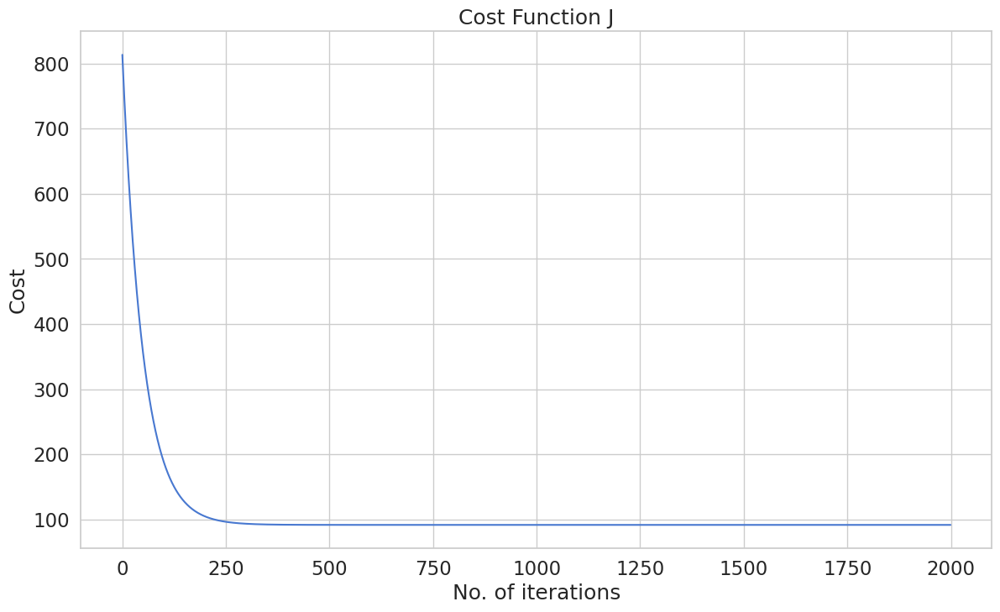

In [30]:
plt.title('Cost Function J')
plt.xlabel('No. of iterations')
plt.ylabel('Cost')
plt.plot(clf._cost_history)
plt.show()

In [31]:
clf._cost_history[-1]

91.63779691903032

In [32]:
#Animation

#Set the plot up,
fig = plt.figure()
ax = plt.axes()
plt.title('Sale Price vs Living Area')
plt.xlabel('Living Area in square feet (normalised)')
plt.ylabel('Sale Price ($)')
plt.scatter(x[:,1], y)
line, = ax.plot([], [], lw=2, color='red')
annotation = ax.text(-1, 700000, '')
annotation.set_animated(True)
plt.close()

#Generate the animation data,
def init():
    line.set_data([], [])
    annotation.set_text('')
    return line, annotation

# animation function.  This is called sequentially
def animate(i):
    x = np.linspace(-5, 20, 1000)
    y = clf._w_history[i][1]*x + clf._w_history[i][0]
    line.set_data(x, y)
    annotation.set_text('Cost = %.2f e10' % (clf._cost_history[i]/10000000000))
    return line, annotation

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=300, interval=10, blit=True)

rc('animation', html='jshtml')

anim

# Multivariable Linear Regression

Let's use more of the available data to build a Multivariable Linear Regression model and see whether or not that will improve our OHMSE error:

In [33]:
x = df_train[['X1 transaction date', 'X2 house age', 'X3 distance to the nearest MRT station']]

x = (x - x.mean()) / x.std()
x = np.c_[np.ones(x.shape[0]), x]

clf = LinearRegression()
clf.fit(x, y, n_iter=2000, lr=0.01)

In [34]:
clf._W

array([37.98019317,  1.79764017, -2.66072795, -9.20677195])

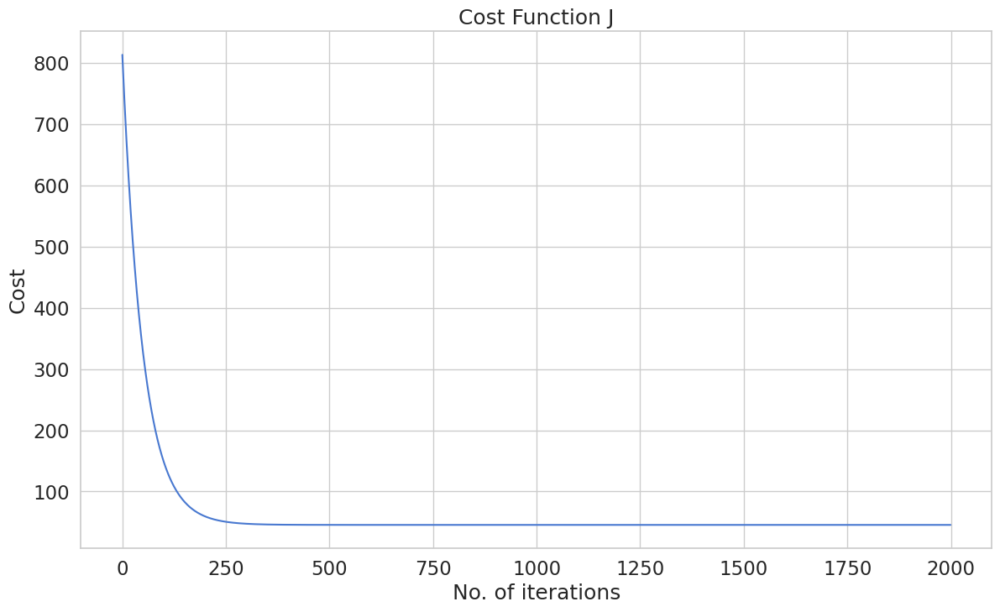

In [35]:
plt.title('Cost Function J')
plt.xlabel('No. of iterations')
plt.ylabel('Cost')
plt.plot(clf._cost_history)
plt.show()

# ***Implementing Multivariable Linear Regression***

This space is intentionally left blank.

## Using Multivariable Linear Regression **bold text** *italicized text*

Now that the implementation of our new model is done, we can use it. Done!?
You see, young padawan, the magical world of software development has those mythical creates called **abstractions**. While it might be extraordinarily hard to get them right, they might reduce the complexity of the code you write by (pretty much) a ton.
You just used one such abstraction — called **vectorization**. Essentially, that allowed us to build a Multivariable Linear Regression model without the need to loop over all features in our dataset.

Our client interface stays the same, too:

In [36]:
clf._cost_history[-1]

45.384418912934855

# ***Conclusion***

Nice! You just implemented a Linear Regression model and not the simple/crappy kind.